# Battery Charge-Discharge Schedule 

In the following notebook we develop an algorithm to charge and discharge a battery being given pv-generation and demand load forecasts. 
The present algorith was developed during the WDP-Catapult challenge with the data in that time provided, now public. The main goal of the challenge was to optimize the use of pv resource and at the same time, reduce as much as possible the afternoons demand load peak.

In [1]:
import numpy as np
import pandas as pd
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot, plot
init_notebook_mode(connected='true')
from datetime import datetime

#if runned in google colab, please run:
#! pip install plotly==4.12
#! pip install chart_studio

### 1. Familiarizing with the data

In [2]:
pv_generation = pd.read_csv('./Data/clean_task4/pv_train_set4.csv', parse_dates = True, index_col = 'datetime')
demand = pd.read_csv('./Data/clean_task4/demand_train_set4.csv', parse_dates = True, index_col = 'Unnamed: 0')

In [3]:
pv_generation = pv_generation.fillna(0)
demand = demand.fillna(0)

In [4]:
#Plotting
Generation = go.Scatter(x=pv_generation.index, y=pv_generation['pv_power_mw'].values, opacity = 0.9, name = 'Power Generation', line=dict(color='orange'), yaxis='y')
Demand = go.Scatter(x=demand.index, y=demand['demand_fit_MW'].values, opacity = 0.9, name = 'Power Demand', line=dict(color='royalBlue'), yaxis='y')

layout = go.Layout(title='PV Generation / Demand', xaxis=dict(title='Datetime'),
                   yaxis=dict(title='MW Average'))
fig = go.Figure(data=[Generation, Demand], layout=layout)
fig.show() # if this is rendered in colab, you should run fig.show(renderer='colab') instead.

We focus on a single day in order to make the testing of the algorithm.

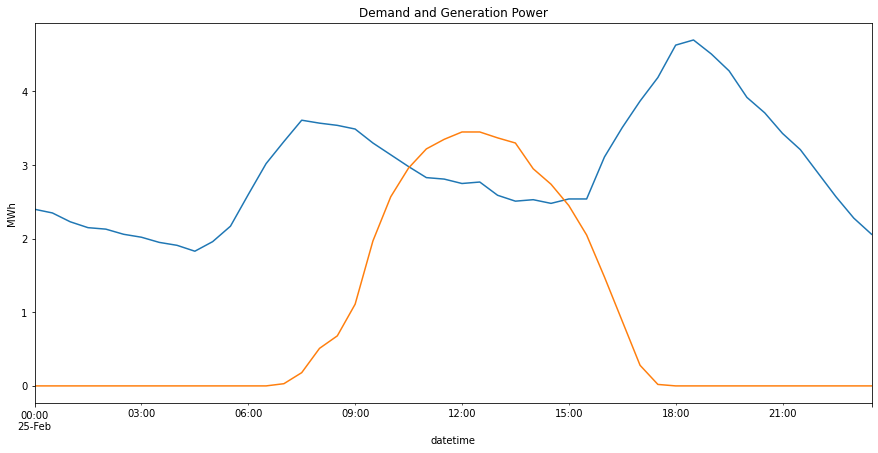

In [5]:
test_day_gen = pv_generation['pv_power_mw'].loc['2019-02-25 00:00:00':'2019-02-25 23:30:00']
test_day_dem = demand['demand_fit_MW'].loc['2019-02-25 00:00:00':'2019-02-25 23:30:00']

test_day_dem.plot(title='Demand and Generation Power', figsize=(15,7))
test_day_gen.plot(ylabel='MW');

### 2. Algorithms Auxiliar Functions

In [6]:
def offset(daily_demand_load_df, C_max, t0 = '15:30:00', t = '21:00:00', resolution = 0.5):
    '''
    Calculates an offset in such a way that the area between the demand load curve and the 
    offset line is the max energy available on the battery (C_max).
    
    inputs:
        daily_demand_load_df: *DataFrame* of a whole day time serie of the power demand.
        
        C_max: *Float* number indicating the battery's maximum capacity in MWh.
        
        t0: *string*. Start of the peaking period. Format 'HH:MM:SS'.
        
        t : *string*. End of the peaking period. Format 'HH:MM:SS'.
        
        resolution: *Float* number indicating resolution of the demand time series in hours. 
                    Default 0.5 hours.
    
    returns A, *Float* with the offset value for the inserted conditions.
    '''
    #converting string to time format
    t0 = datetime.strptime( t0 , '%H:%M:%S')
    t = datetime.strptime( t , '%H:%M:%S')
    
    #calculation of the integral with Riemann Sum.
    L = daily_demand_load_df.values #demand load
    I = 0
    for i in range(len(daily_demand_load_df.index)):
        time_ = daily_demand_load_df.index[i].time()
        
        if t0.time() <= time_ < t.time():
            I = I + resolution*L[i]    #resulting value of the integral
    dt = t - t0
    dt = dt.seconds/3600
    A = (I - C_max)/dt
    return A

def charge_state_from_charge_rate(charge_rate_df, resolution = 0.5):
    '''
    This function generates a time serie of the charged energy in the battery (in MWh), with
    the charge rate time serie being given. The resolution of the ts needs to be as well 
    specified.
    '''
    B = charge_rate_df.values    
    C = np.zeros(len(B))
    
    for i in range(1, len(B)):
        C[i] = C[i-1] + resolution*B[i-1]
        
    charge_state = pd.DataFrame(data=C, columns=['total_charge_MWh'], index = charge_rate_df.index )
    return charge_state

def charge_rate_from_charge_state(charge_state_df, resolution):
    '''
    This function generates a time serie of the charge rate of the battery (in MW), with
    the total charge time serie being given. The resolution of the ts needs to be as well 
    specified.
    '''
    C = charge_state_df.values    
    B = np.zeros(len(C))
    
    for i in range(len(C)-1):
        B[i] = (C[i+1] - C[i])/resolution
        
    charge_rate = pd.DataFrame(data=B, columns=['charge_MW'], index = charge_state_df.index)
    return charge_rate

def get_start_end_time_generation(test_day_gen):
    '''
    The function returns an estimated time window of the time at which the sun is out. 
    It results useful in the cae that the generation timeserie is noisy before the sunrise.
    
    input: 
            test_day_gen: DataFrame with a one-day PV power generation time serie.
    output:
            ta: sunrise time.
            tb: sundown time.
    '''
    for i in range(3, len(test_day_gen) - 3):
        if test_day_gen.values[i] > 0:
            if test_day_gen.values[i-1] == 0 and test_day_gen.values[i-2] == 0 and test_day_gen.values[i-3] == 0:
                ta = test_day_gen.index[i]
            if test_day_gen.values[i+1] == 0 and test_day_gen.values[i+2] == 0 and test_day_gen.values[i+3] == 0:
                tb = test_day_gen.index[i]
        else:
            ta = datetime.strptime( '07:30:00' , '%H:%M:%S')
            tb = datetime.strptime( '17:30:00' , '%H:%M:%S')
    return ta, tb

def adjust_probability_generation(daily_generation_df, tx = '15:00:00', C_max = 6, resolution = 0.5):
    '''
    This function does a reescalement of a one-day generation power time series, so that the 
    total energy produced by time 'tx' is the same as the total maximum charge capacity of the 
    battery 'C_max' in MWh. The resolution of the time serie must be specified in hours.
    '''
    tx = datetime.strptime( tx , '%H:%M:%S')
    ta, tb = get_start_end_time_generation(daily_generation_df)
    #t_df = pd.DataFrame(data=f, columns = ['Normal'], index = daily_generation_df.index)
    #calculation of the integral with Riemann Sum.
    P = daily_generation_df.values
    I = 0
    for i in range(len(daily_generation_df.index)):
        time_ = daily_generation_df.index[i].time()
        if ta.time() <= time_ <= tx.time():
            I = I + resolution*P[i]    #resulting value of the integral
            #print(I)
    if I != 0:
        B = C_max/I
    else: 
        B = 0
    P_df = pd.DataFrame(data=B*P, columns = ['Generation_Prob_[MW]'], index = daily_generation_df.index)
    return P_df

Below you can find an example of the reescalement being done in `adjust_probability_generation`

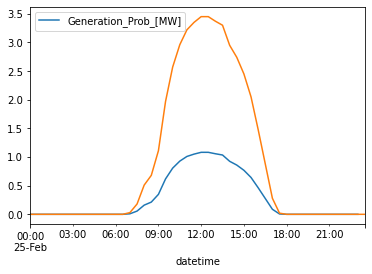

In [7]:
P = adjust_probability_generation(test_day_gen.iloc[:-1], tx = '15:00:00')
P.plot()
test_day_gen.plot();

### 3. Main Algorithm

We need to define the specs of the battery beforehand in a dictionary.

In [8]:
battery_specs = dict( 
                    B_max = 2.5, #maximum charging rate #[MW]
                    C_max = 6.0, #maximum charge capacity #[MWh]
                    C_min = 0.0, #minimum charge capacity #[MWh]
                    )

In [9]:
def battery_charge_schedule(generation_df, demand_load_df, battery_specs, resolution = 0.5):
    '''
    Main algorithm for the charge-discharge daily schedule.
    
    inputs: 
            generation_df: DataFrame with the power generation time serie. Can be a day or more.
            demand_load_df: DataFrame with the load demand time serie. Time series must be same 
                            sized.
            battery_specs: Dictionary with B_max, C_max, C_min, where B is the charge rate 
                            and C is the charging capacity.
            resolution: time series resolution in hours.
        
    '''
    #defining features of the battery
    B_max = battery_specs['B_max'] #[MW]
    C_max = battery_specs['C_max']#[MWh]
    C_min = battery_specs['C_min'] #[MWh]
    
    #we generate arrays for the charging rate and charge info 
    C = np.zeros(generation_df.shape[0])
    B = np.zeros(generation_df.shape[0])
    A = np.zeros(generation_df.shape[0])
    
    #we get arrays from the generation and demand power time series.
    P = generation_df.values #PV generation
    L = demand_load_df.values #demand load
    
    #loop over the time steps (half hours)
    for i in range(1,len(generation_df.index)):
        
        date_aux = demand_load_df.index[i-1].date() #get date from previous time step
        date_ = demand_load_df.index[i].date() #get date from actual time step
        time_ = generation_df.index[i].time() #get time from actual time step
        
        #getting daily demand and generation data out of the whole day of the timestep
        dti = datetime.strptime(str(date_) + ' ' + str('00:00:00'), '%Y-%m-%d %H:%M:%S') #build of initial time
        dtf = datetime.strptime(str(date_) + ' ' + str('23:30:00'), '%Y-%m-%d %H:%M:%S') #build of the final time
        daily_demand_load_df = demand_load_df.loc[dti:dtf]
        daily_generation_df = generation_df.loc[dti:dtf]

        #making time series rescaling
        generation_prob_df = adjust_probability_generation(daily_generation_df, tx = '15:00:00')

        #getting all the reescaled days together to build a complete reescaled time serie.
        if i == 1:
            p = generation_prob_df.values
        elif (date_ - date_aux).total_seconds() != 0:
            p = np.concatenate((p, generation_prob_df.values))
        
        #****************** charging period *********************
        
        #conditions for charging period. If the timestep time is between this time window...
        if datetime.strptime('04:30:00', '%H:%M:%S').time() < time_ <= datetime.strptime('15:30:00', '%H:%M:%S').time():
                
            #setting charge status, i.e. charging. Note that the charging only depends on the
            # charge rate of the previous timestep.
            if C[i-1] == C_max:
                C[i] = C_max
            elif C[i-1] + resolution*B[i-1] <= C_max:
                C[i] = C[i-1] + resolution*B[i-1]
            elif C[i-1] + resolution*B[i-1] > C_max:
                if C[i-1] == C_max:
                    C[i] = C_max
                elif C[i-1] < C_max: 
                    B[i-1] = (C_max - C[i-1])/resolution
                    C[i] = C[i-1] + resolution*B[i-1]
                if C[i] > C_max:
                    C[i] = C_max    
                    
             #setting charge rate for present timestep using reescaled generation timeserie and 
            # present charge status
            if p[i] > B_max:
                B[i] = B_max 
            if p[i] <= B_max:
                B[i] = p[i] 
            if C[i] >= C_max: #if the battery is already full....
                B[i] = 0.0
            if time_ == datetime.strptime('15:30:00', '%H:%M:%S').time(): #if you reach the end of charge period...
                B[i] = 0        #discharging
        
        #****************** discharge period *********************
        if i > 24:
            A[i] = offset(daily_demand_load_df, C_max = C[i-24:i+1].max()) #getting offset for the present day.
        else:
            A[i] = offset(daily_demand_load_df, C_max = C.max())
            
        #conditional for the peak period.
        if datetime.strptime('15:30:00', '%H:%M:%S').time() <= time_ <= datetime.strptime('21:00:00', '%H:%M:%S').time():
            
            if L[i] > A[i]: #if the load is greater than the offset...
                if L[i] - A[i] > B_max: #if the diference between the demand and offset is
                                        # greater than the max discharge rate...
                    B[i] = - B_max
                elif 0.0 <= L[i] - A[i] <= B_max: #if it is less but greater than zero.
                    B[i] = A[i] - L[i]
                else:
                    B[i] = 0.0
            else:
                B[i] = 0.0
            
            if time_ == datetime.strptime('21:00:00', '%H:%M:%S').time(): #if you reach the end of charge period...
                B[i] = 0 
                
            if C[i-1] == C_min and B[i-1] <= 0: # if a the previous time the battery was fully discharged...
                C[i] = C_min #set battery charge state to zero
                B[i] = 0.0 #can't discharge no more

            elif C[i-1] > C_min: # if in the previous time, there was any charge...
                C[i] = C[i-1] + resolution*B[i-1] #set new charge status as...
                if C[i] < C_min: 
                    B[i-1] = -(C[i-1]-C_min)/resolution
                    C[i] = C_min
                    B[i] = 0.0
            

    #write final DataFrames with the calculated schedules    
    Charge_rate = pd.DataFrame(data = B, index = generation_df.index, columns = ['charge_MW'])
    Total_charge = pd.DataFrame(data = C, index = generation_df.index, columns = ['total_charge_MWh'])
    Offset =  pd.DataFrame(data = A, index = generation_df.index, columns = ['daily_offset'])

    return Charge_rate , Total_charge, Offset

### 4. Algorithm Testing

We execute some tests on the algorithm with the data to see if it works as it should. 

#### 4.1 No surpassing of Battery Specs limits

In [10]:
#executing main algorithm on one day dataframe
Charge_rate_test, total_charge, offset_daily = battery_charge_schedule(test_day_gen, 
                                                                       test_day_dem, 
                                                                       battery_specs = battery_specs,
                                                                      resolution = 0.5)


In [11]:
Charge_rate_test.values.max(), total_charge.values.max(), Charge_rate_test.values.min(), total_charge.values.min()

(1.0820700470465237, 6.0, -1.8845454545454543, 0.0)

For the one-day data it appears to work fine, because:
- The max charge rate was 1.62 < 2.5 = B_max
- The max discharge rate, which was -1.7 > -2.5 = B_min = -B_max.
- The battery charging limits were reached but no surpassed.

#### 4.2 Reconstructed charge rate and state time series are the same as the original ones.

We expect that the reconstructed time series, which followed the discharging equations
$$C[i] = C[i-1] + resolution*B[i]$$,
are exactly the same as the originals. That would imply that the implemented logic in the main algorithm was correct. In order to check that one out, we'll explore the following plot.

In [12]:
Charge_rate_reconstructed = charge_rate_from_charge_state(total_charge, resolution = 0.5 )
Charge_state_reconstructed = charge_state_from_charge_rate(Charge_rate_reconstructed, resolution = 0.5)

In [13]:
Charge_Profile = go.Scatter(x=Charge_rate_test.index, y=Charge_rate_test['charge_MW'].values, opacity = 0.5, name = 'Charge Rate', line=dict(color='crimson'), yaxis='y')
Charge_Profile_r = go.Scatter(x=Charge_rate_reconstructed.index, y=Charge_rate_reconstructed['charge_MW'].values, opacity = 0.5, name = 'Charge Rate Reconstructed', line=dict(color='lightblue'), yaxis='y')

Total_charge = go.Scatter(x=total_charge.index, y=total_charge['total_charge_MWh'].values, opacity = 0.5, name = 'Charge State', line=dict(color='magenta'), yaxis='y2')
Total_charge_r = go.Scatter(x=Charge_state_reconstructed.index, y=Charge_state_reconstructed['total_charge_MWh'].values, opacity = 0.5, name = 'Charge State Reconstructed', line=dict(color='green'), yaxis='y2')

layout = go.Layout(title='PV Generation / Demand', xaxis=dict(title='Datetime'),
                   yaxis=dict(title='MW Average'),
                  yaxis2=dict(title='MWh Average', side='right', overlaying='y'))
fig = go.Figure(data=[Charge_Profile, Charge_Profile_r, Total_charge, Total_charge_r], layout=layout)
fig.show() # if this is rendered in colab, you should run fig.show(renderer='colab') instead.

When exploring the graph we can see that the reconstructed and original time series are in fact the same. And we double check right away.

In [14]:
all(Charge_rate_reconstructed.values) == all(Charge_rate_test.values)

True

#### 4.3 The charged energy is greater or equal than the discharged one.

We proceed to sum the charge rate values to determine wether more or less power was charged.

In [15]:
sum(Charge_rate_test.values), sum(Charge_rate_reconstructed.values)

(array([0.]), array([0.]))

We observe that both of the time series (original and reconstructed) sum up zero. That means that the same ammount of power is charged and discharged.

#### 4.4 Repeat previous tests with the full dataset.

In [16]:
# retrieving ful dataset
full_gen = pv_generation['pv_power_mw']
full_dem = demand['demand_fit_MW']

In [17]:
#repeating for the whole dataset
Charge_rate_all, total_charge_all, offset_all = battery_charge_schedule(full_gen, full_dem, battery_specs = battery_specs, resolution = 0.5)

In [18]:
total_charge_all.values.max(), Charge_rate_all.values.max(), total_charge_all.values.min(), Charge_rate_all.values.min()

(6.0, 2.5, 0.0, -1.954545454545455)

The limit battery specs values are according to what was expected.

In [19]:
charge_rate_reconstructed = charge_rate_from_charge_state(total_charge_all, resolution = 0.5)
charge_state_reconstructed = charge_state_from_charge_rate(charge_rate_reconstructed, resolution = 0.5)

In [20]:
Charge_Profile = go.Scatter(x=Charge_rate_all.index, y=Charge_rate_all['charge_MW'].values, opacity = 0.5, name = 'Charge Rate', line=dict(color='crimson'), yaxis='y')
Charge_Profile_r = go.Scatter(x=charge_rate_reconstructed.index, y=charge_rate_reconstructed['charge_MW'].values, opacity = 0.5, name = 'Charge Rate Reconstructed', line=dict(color='lightblue'), yaxis='y')

Total_charge = go.Scatter(x=total_charge_all.index, y=total_charge_all['total_charge_MWh'].values, opacity = 0.5, name = 'Charge State', line=dict(color='magenta'), yaxis='y2')
Total_charge_r = go.Scatter(x=charge_state_reconstructed.index, y=charge_state_reconstructed['total_charge_MWh'].values, opacity = 0.5, name = 'Charge State Reconstructed', line=dict(color='green'), yaxis='y2')

layout = go.Layout(title='PV Generation / Demand', xaxis=dict(title='Datetime'),
                   yaxis=dict(title='MW Average'),
                  yaxis2=dict(title='MWh Average', side='right', overlaying='y'))
fig = go.Figure(data=[Charge_Profile, Charge_Profile_r, Total_charge, Total_charge_r], layout=layout)
fig.show() # if this is rendered in colab, you should run fig.show(renderer='colab') instead.

Reconstucted timeseries appear to be the same. In the following lines of code we can check that they are in fact the same.

In [21]:
all(charge_rate_reconstructed.values) == all(Charge_rate_all.values)

True

In [22]:
sum(Charge_rate_all.values), sum(charge_rate_reconstructed.values)

(array([1.687539e-12]), array([0.]))

The charge rates sum up to zero. This is one more time satisfied, meaning that the used energy is not larger than the charged one.

### 5. A Little Extra Insight

Here we show a small one-day plot with which we'd expect that the intuition behind the problems approach it's a little clearer.

In [23]:
#interactive plotting
Generation = go.Scatter(x=test_day_gen.index, y=test_day_gen.values, opacity = 1, name = 'Power Generation', line=dict(color='orange'), yaxis='y')
Demand = go.Scatter(x=test_day_dem.index, y=test_day_dem.values, opacity = 1, name = 'Power Demand', line=dict(color='royalBlue'), yaxis='y')

Charge_Profile = go.Scatter(x=Charge_rate_test.index, y=Charge_rate_test['charge_MW'].values, opacity = 1, name = 'Charge Rate', line=dict(color='crimson'), yaxis='y2')

Total_charge = go.Scatter(x=total_charge.index, y=total_charge['total_charge_MWh'].values, opacity = 1, name = 'Charge State', line=dict(color='magenta'), yaxis='y2')

Offset = go.Scatter(x=offset_daily.index, y=offset_daily['daily_offset'].values, opacity = 1, name = 'Offset', line=dict(color='black'), yaxis='y')

t0 = datetime.strptime('2019-02-25 15:30:00', '%Y-%m-%d %H:%M:%S') #peak hours time interval
t = datetime.strptime('2019-02-25 21:00:00', '%Y-%m-%d %H:%M:%S')

layout = go.Layout(title='PV Generation / Demand', xaxis=dict(title='Datetime'),
                   yaxis=dict(title='MWh'),
                  yaxis2=dict(title='MWh', side='right', overlaying='y'))
fig = go.Figure(data=[Generation, Demand, Charge_Profile, Total_charge, Offset], layout=layout)
fig.add_vline(x=t0)
fig.add_vline(x=t)
fig.show() # if this is rendered in colab, you should run fig.show(renderer='colab') instead.

----